In [1]:

import os 
import sys
import yaml
import json
from pprint import pprint
from glob import glob
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import cv2
import xml.etree.ElementTree as ET
from svglib.svglib import svg2rlg
from reportlab.graphics import renderPM


import open3d as o3d
import trimesh
import plotly.graph_objects as go
import PIL
from PIL import Image



def visualize_meshes_plotly(
    mesh_list, color_list=None,
    vertex_list = None
):
    if not isinstance(mesh_list, list):
        mesh_list = [mesh_list]
    
    final_mesh_list = []
    for mesh in mesh_list:
        if isinstance(mesh, str):
            mesh = trimesh.load(mesh)
        final_mesh_list.append(mesh)
    
    if color_list is None:
        color_list = ['lightgray'] * len(final_mesh_list)
    
    # Create the 3D scatter plot for vertices
    fig = go.Figure(data=[
        go.Mesh3d(
            x=mesh.vertices[:, 0],
            y=mesh.vertices[:, 1],
            z=mesh.vertices[:, 2],
            i=mesh.faces[:, 0],
            j=mesh.faces[:, 1],
            k=mesh.faces[:, 2],
            opacity=0.5,
            facecolor=mesh.visual.face_colors[:, :3] if hasattr(mesh.visual, 'face_colors') else None,
            color=None if hasattr(mesh.visual, 'face_colors') else color
        ) for mesh, color in zip(final_mesh_list, color_list)
    ])
    
    
    if vertex_list is not None:
        fig.add_trace(go.Scatter3d(
            x=vertex_list[:, 0],
            y=vertex_list[:, 1],
            z=vertex_list[:, 2],
            mode='markers',
            marker=dict(
                size=5,
                color='blue',
                opacity=1
            ),
            name='Vertices'
        ))
        
        
    # Update the layout
    fig.update_layout(
        scene=dict(
            aspectmode='data'  # Preserve aspect ratio
        ),
        width=800,
        height=800,
        showlegend=False
    )
    
    # Show the plot
    fig.show()
    
    
def v_id_map(vertices): 
    v_map = [None] * len(vertices) 
    v_map[0] = 0 
    for i in range(1, len(vertices)): 
        if all(vertices[i - 1] == vertices[i]): 
            v_map[i] = v_map[i-1]   
        else: 
            v_map[i] = v_map[i-1] + 1 
    return v_map


PROJECT_ROOT_PATH = "/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/GarmentCodeData/"
GARMENT_ROOT_PATH = os.path.join(PROJECT_ROOT_PATH, "GarmentCodeData_v2")
BODY_ROOT_PATH = os.path.join(PROJECT_ROOT_PATH, "body_mesh")
MEAN_ALL_BODY_PATH = os.path.join(PROJECT_ROOT_PATH, "neutral_body/mean_all.obj")
    
default_body_mesh = trimesh.load(MEAN_ALL_BODY_PATH)
print(default_body_mesh.vertices.shape)
print(default_body_mesh.faces.shape)

# visualize_mesh_plotly(MEAN_ALL_BODY_PATH)

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
(23751, 3)
(47500, 3)


In [2]:
default_body_mesh.vertices[:, 1].mean()

1.0659816312103532

In [3]:
sorted(list(map(
    lambda x : (x.split("/")[-2], len(os.listdir(x))),
    list(filter(
        os.path.isdir,
        glob(os.path.join(GARMENT_ROOT_PATH, "*", "default_body"))
    ))
)))

[('garments_5000_0', 3452),
 ('garments_5000_1', 3416),
 ('garments_5000_10', 3780),
 ('garments_5000_11', 3834),
 ('garments_5000_12', 3821),
 ('garments_5000_13', 3807),
 ('garments_5000_14', 3839),
 ('garments_5000_15', 3833),
 ('garments_5000_16', 3867),
 ('garments_5000_17', 3853),
 ('garments_5000_18', 3846),
 ('garments_5000_19', 3851),
 ('garments_5000_2', 3432),
 ('garments_5000_20', 3808),
 ('garments_5000_21', 3403),
 ('garments_5000_22', 3369),
 ('garments_5000_23', 3469),
 ('garments_5000_24', 3443),
 ('garments_5000_25', 3462),
 ('garments_5000_26', 3747),
 ('garments_5000_27', 3807),
 ('garments_5000_28', 3740),
 ('garments_5000_29', 3770),
 ('garments_5000_3', 3407),
 ('garments_5000_30', 3844),
 ('garments_5000_31', 3869),
 ('garments_5000_32', 3849),
 ('garments_5000_33', 3809),
 ('garments_5000_34', 3887),
 ('garments_5000_35', 3815),
 ('garments_5000_4', 3475),
 ('garments_5000_5', 3426),
 ('garments_5000_6', 3458),
 ('garments_5000_7', 3734),
 ('garments_5000_8', 3

## Visualize Default Body Setting

In [4]:
len(glob(os.path.join(GARMENT_ROOT_PATH, "*", "default_body", "*")))

132742

## Note

garment_5000_27/random_body/dataset_properties_random_body.yaml 도 고려해야 함

In [5]:
IDX = 0
# BODY_TYPE = "random_body"
BODY_TYPE = "default_body"

garment_path = sorted(list(filter(
    os.path.isdir,
    glob(os.path.join(GARMENT_ROOT_PATH, "*", BODY_TYPE, "*"))
)))[IDX]
garment_id = os.path.basename(garment_path)

print(garment_path)
print(garment_id)

os.listdir(garment_path)

/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/GarmentCodeData/GarmentCodeData_v2/garments_5000_0/default_body/rand_00YONAPXZE
rand_00YONAPXZE


['rand_00YONAPXZE_pattern.png',
 'rand_00YONAPXZE_texture.png',
 'rand_00YONAPXZE_specification.json',
 'signed_distance_metadata.json',
 'rand_00YONAPXZE_boxmesh.ply',
 'rand_00YONAPXZE_sim_segmentation.txt',
 'rand_00YONAPXZE_body_measurements.yaml',
 'closest_edge_indices_grid.npy',
 'signed_distance_grid.npy',
 'rand_00YONAPXZE_render_front.png',
 'rand_00YONAPXZE_orig_lens.pickle',
 'rand_00YONAPXZE_render_back.png',
 'rand_00YONAPXZE_vertex_labels.yaml',
 'rand_00YONAPXZE_pattern.svg',
 'rand_00YONAPXZE_sim.ply',
 'rand_00YONAPXZE_design_params.yaml']

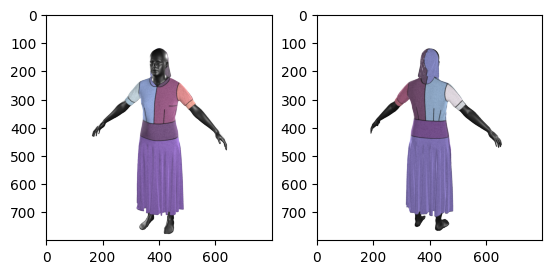

In [6]:
plt.subplot(1, 2, 1)
plt.imshow(PIL.Image.open(os.path.join(garment_path, f"{garment_id}_render_front.png")))
plt.subplot(1, 2, 2)
plt.imshow(PIL.Image.open(os.path.join(garment_path, f"{garment_id}_render_back.png")))
plt.show()

In [7]:
with open(os.path.join(garment_path, f"{garment_id}_orig_lens.pickle"), "rb") as f:
    orig_lens = pickle.load(f)

len(orig_lens)

6608

In [7]:
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = f.readlines()

print(len(segmentation))


28817


In [8]:
# render:
#   config:
#     resolution:
#     - 800
#     - 800
#     sides:
#     - front
#     - back
#     front_camera_location:
#     - 0
#     - 0.97
#     - 4.15
#     uv_texture:
#       seam_width: 0.5
#       dpi: 1500
#       fabric_grain_texture_path: ./assets/fabric_texture.png
#       fabric_grain_resolution: 5
      

In [11]:
PIL.Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))

tex_image = PIL.Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))

tex_image.size


(4582, 2655)

In [9]:
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = f.readlines()
print(len(segmentation))

stitch_vertex_mask_raw = np.array(list(map(
    lambda x : True if x.startswith("stitch") else False,
    segmentation
)))
print(stitch_vertex_mask_raw.shape, stitch_vertex_mask_raw.sum())

28817
(28817,) 935


In [12]:
simulated_garment_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_sim.ply"),
    process=False
    )
texture = trimesh.visual.TextureVisuals(
    simulated_garment_mesh.visual.uv,
    image=tex_image
)
simulated_garment_mesh.visual = texture

print("vertices", simulated_garment_mesh.vertices.shape)
print("faces", simulated_garment_mesh.faces.shape)

idx_convert_map = v_id_map(simulated_garment_mesh.vertices)

print("idx_convert_map length", len(idx_convert_map))
print("idx_convert_map", idx_convert_map)
print()


stitch_vertex_mask = np.array(list(map(
    lambda idx : True if stitch_vertex_mask_raw[idx] else False,
    idx_convert_map
)))

print("stitch_vertex_mask", stitch_vertex_mask.shape, stitch_vertex_mask.sum())

vertices (29784, 3)
faces (57130, 3)
idx_convert_map length 29784
idx_convert_map [0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9, 10, 10, 11, 11, 12, 12, 13, 13, 14, 14, 15, 15, 16, 16, 17, 17, 18, 18, 19, 19, 20, 20, 21, 21, 22, 22, 23, 23, 24, 24, 25, 25, 26, 26, 27, 27, 28, 28, 29, 29, 30, 30, 31, 31, 32, 32, 33, 33, 34, 34, 35, 35, 36, 36, 37, 37, 38, 38, 39, 39, 40, 40, 41, 41, 42, 42, 43, 43, 44, 44, 45, 45, 46, 46, 47, 47, 48, 48, 49, 49, 50, 50, 51, 51, 52, 52, 53, 53, 54, 54, 55, 55, 56, 56, 57, 57, 58, 58, 59, 59, 60, 60, 61, 61, 62, 62, 63, 63, 64, 64, 65, 65, 66, 66, 67, 67, 68, 68, 69, 69, 70, 70, 71, 71, 72, 72, 73, 73, 73, 73, 74, 74, 74, 74, 75, 75, 76, 76, 77, 77, 78, 78, 79, 79, 80, 80, 81, 81, 82, 82, 83, 83, 84, 84, 85, 85, 86, 86, 87, 87, 88, 88, 89, 89, 90, 90, 91, 91, 92, 92, 93, 93, 94, 94, 95, 95, 96, 96, 97, 97, 98, 98, 99, 99, 100, 100, 101, 101, 102, 102, 103, 103, 104, 104, 105, 105, 106, 106, 107, 107, 108, 108, 109, 109, 110, 110, 111, 111, 1

In [13]:
stitch_vertices = simulated_garment_mesh.vertices[stitch_vertex_mask]

visualize_meshes_plotly(
    [
        simulated_garment_mesh,
        default_body_mesh
    ],
    color_list=["red", "blue"],
    vertex_list=stitch_vertices
)

In [10]:
import random

random.randint(0, 1)

0